In [ ]:
# !pip install plotly
import seaborn as sns
from plotly import graph_objs as go
from plotly.offline import iplot, init_notebook_mode
import plotly.express as px
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import gc
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import timeit
import os
# get the default figure size
sns.set(rc={'figure.figsize':(15,5)})

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [4]:
%%time
dir_ = './drive/My Drive/data/case_study_1/'
# read the data files into memeories
train_df = pd.read_feather(dir_ + 'train.feather')
weather_train_df = pd.read_feather(dir_ + 'weather_train.feather')
test_df = pd.read_feather(dir_ + 'test.feather')
weather_test_df = pd.read_feather(dir_ + 'weather_test.feather')
building_meta_df = pd.read_feather(dir_ + 'building_metadata.feather')
sample_submission = pd.read_feather(dir_ + 'sample_submission.feather')

CPU times: user 920 ms, sys: 2.7 s, total: 3.62 s
Wall time: 27.8 s


In [5]:
def add_time_features(df):
    """Add date time features by parsing timestamp"""
    # add dayofyear column
    df["dayofyear"] = df.timestamp.dt.dayofyear
    # add day column
    df["day"] = df.timestamp.dt.day
    # add week column
    df["week"] = df.timestamp.dt.week
    # add hour column
    df["hour"] = df.timestamp.dt.hour
    # add month column
    df["month"] = df.timestamp.dt.month
    # add weekend column
    df["weekend"] = df.timestamp.dt.weekday.apply(lambda x: 0 if x <5 else 1)

In [ ]:
# add time features to the train df
add_time_features(train_df)

# and time features to the test df
add_time_features(test_df)

# and time features to weather train df
add_time_features(weather_train_df)

# and time features to weather test df
add_time_features(weather_train_df)

In [ ]:
'''as evaluation metric uses log(1 + target value),
we will apply the same operation to the target variable to scale it down'''

train_df["target"] = np.log1p(train_df.meter_reading)

'''adding site id column to the train data'''

# create a series object
s1 = pd.Series(building_meta_df.site_id.values, index =building_meta_df.building_id.values)

# add a site_id column to the train dataframe
train_df["site_id"] = train_df["building_id"].map(s1)

# Get basic information about the dataset

In [ ]:
# lets see that feature and data type does train set contains
train_df.head()

,building_id,meter,timestamp,meter_reading,dayofyear,day,week,hour,month,weekend,target,site_id
0,0,0,2016-01-01,0.0,1,1,53,0,1,0,0.0,0
1,1,0,2016-01-01,0.0,1,1,53,0,1,0,0.0,0
2,2,0,2016-01-01,0.0,1,1,53,0,1,0,0.0,0
3,3,0,2016-01-01,0.0,1,1,53,0,1,0,0.0,0
4,4,0,2016-01-01,0.0,1,1,53,0,1,0,0.0,0


In [ ]:
'''
print the basic information about train data
'''

key_list = ["Min date value in the train set",
            "Max date value in the train set",
            "No of unique buildings",
            "No of rows in the train set",
            "Min date value in the train set",
            "Max date value in the train set",
            "No of unique site id (location)"]


value_list = [train_df.timestamp.min(),
              train_df.timestamp.max(),
              train_df.building_id.unique().__len__(),
              train_df.__len__(),
              train_df.meter_reading.min(),
              train_df.meter_reading.max(),
              train_df.site_id.unique().__len__()]

group_list = zip(key_list, value_list)
for group in group_list:
    print(group[0], group[1])

Min date value in the train set 2016-01-01 00:00:00
Max date value in the train set 2016-12-31 23:00:00
No of unique buildings 1449
No of rows in the train set 20216100
Min date value in the train set 0.0
Max date value in the train set 21904700.0
No of unique site id (location) 16


# Observation

* We have details about building id (a number used to identify buildings), meter type {0: electricity, 1: chilledwater, 2: steam, 3: hotwater}, timestamp (time at with reading was recorded) and the meter reading (meter reading is our target variable)

* We are given the timestamp, here we are dealing with time-series data

* This train dataset contains meter reading entries(4 meter types) of year 2016(366 days) for 1449 unique buildings per hour (total row should be 366 * 24 * 4 * 1449) = _50912064_

* We have _20,216,100_ meter reading entries. The reason why we have 20 million records and not 50 million is that not all the buildings have all types of meters.

* Minimum meter reading is _0_ and maximum meter reading is _21904700.0_ (both are probably outliers)

* There are a total of 16 different sites


* So, we also have meter reading value "0", which is quite unusual. Asking myself, when do you have a meter reading 0? Turns out, there could be plenty of reasons.
  * **Power outage**: This could be one of many reasons when we could get a meter reading of 0. Though I also believe it could be marked as  "nan" (missing) because there is no reading to read.

 * **Seasonal reasons**: We have 4 meter types (0:electricity, 1: chilledwater, 2: steam, 3: hotwater), If we have 0 meter reading for any among 3 meters (excluding electricity meter, because overall electricity will be used) it might because chilled water won't be used in winter season or hotwater or steam devices are not used at all in the summer season.

 * **Closed building, Under construction or At maintenance**: This could be another factor when we have a meter reading of 0.

 * **Error in measuring instrument(error in the meter itself)**: This could be another reason, Here there is a glitch or fault in the instrument itself.


# Looking at building which has meter reading 21904700.0 (an otlier)

In [ ]:
# get the building id of building where meter reading is 21904700.0
train_df.building_id[train_df.meter_reading == 21904700.0]

8907488    1099
Name: building_id, dtype: int64

In [9]:
''''
building 1099 has only two meter type, 0 and 2
'''

for meter_id in range(0, 3, 2):
  # set the data
  bid = 1099
  d1 = go.Scatter(
      x = train_df.timestamp[(train_df.meter == meter_id) & (train_df.building_id == bid)],
      y = train_df.meter_reading[(train_df.meter == meter_id) & (train_df.building_id == bid)],
      mode= "lines"
  )
# set the appearance
  layout = dict(width = 800,
                height= 400,
                title = f'Distribution of meter {meter_id} reading for Building {bid} over time',
                xaxis= dict(title= 'Date',ticklen= 1,zeroline= False),
                yaxis= dict(title= f'meter {meter_id} reading',ticklen= 1,zeroline= False))

  fig = dict(data = d1, layout = layout)
  # plot the data
  iplot(fig)

* For electricity meter (meter 0), we see a normal pattern there is no suspicion.

* For steam meter (meter 2), Meter reading after around march , is in millions, which is quite bizarre. Here we will treat it as an outlier and perform one of two things. 1) Remove it. 2) Winsorize it (using mean or some other averaging method)

# Looking at  the percentile of meter reading

In [64]:
'''
Compute the percentile and visualize it
'''
percentile_idx = np.linspace(0, 1, 100)
q = train_df.meter_reading.quantile(q = percentile_idx.round(2)).round(2).values
df_percentile = pd.DataFrame({"percentile":percentile_idx, "percentile_value": q})

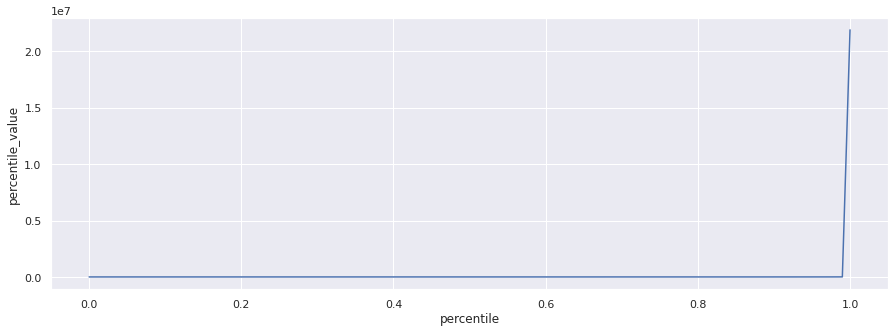

In [66]:
sns.lineplot(x= "percentile", y= "percentile_value", data= df_percentile)

**There seems to be a huge outlier in 99th percentile which we know is from building 1099 (meter type 2) having meter readings in millions**.

* This outlier could heavily skew our result. We will try winsorizing (bringing down the values) or dropping the whole entry.

# Distribution of target variable(meter reading of electric meter) at site id 0 across 20 randomly selected buildings

In [ ]:
# sample building id
sample_bid = []
for i in range(20):
    # pick up building id randomly
    bid = train_df.building_id.sample().values[0]
    sample_bid.append(bid)
    d1 = go.Scatter(
        x = train_df.timestamp[(train_df.meter == 0) & (train_df.building_id == bid)],
        y = train_df.meter_reading[(train_df.meter == 0) & (train_df.building_id == bid)],
        mode= "lines"
    )

    layout = dict(width = 800,
                  height= 400,
                  title = 'Distribution of electricity meter reading for Building {} over time'.format(bid),
                  xaxis= dict(title= 'Date',ticklen= 1,zeroline= False),
                  yaxis= dict(title= 'meter 0 reading',ticklen= 1,zeroline= False))

    fig = dict(data = d1, layout = layout)
    iplot(fig)

# Observation
* For some building, There are 0 meter reading for electricity meter in consecutive days (and then sudden spike).
<img src= "https://i.imgur.com/OQfBqLw.png"/>
<img src="https://i.imgur.com/rdqIObn.png"/>

* There are cases when we have the same reading for multiple days in a row
<img src="https://i.imgur.com/rMFpRCA.png"/>


* All these seem unusual to me. We will try to use time series imputation techniques to fix these holes.


# Draw heatmap (of zero meter reading count) to see the big picture
## Electricity meter reading heatmap

In [ ]:
'''
create zero count dataframe (meter 0 (electric meter))
'''
# get day of the year
train_df["dayofyear"] = train_df.timestamp.apply(lambda x: x.dayofyear)

# only take  "building_id", "meter_reading", "dayofyear" and "meter"columns
subset_df =train_df[["building_id", "meter_reading", "dayofyear", "meter"]]

# generate a dataframe that counts zero meter reading for each day and for each building
zero_count_df = subset_df.groupby(["dayofyear", "building_id", "meter"]).agg({"meter_reading": lambda x: x.eq(0).sum()}).reset_index()

# change the column name
zero_count_df.columns = ['dayofyear', 'building_id', "meter", 'zero_count']

# save the csv format to the disk
zero_count_df.to_feather(dir_ + "zero_count(meter_0).feather")

In [ ]:
# load the zero count csv file
zero_count_df = pd.read_feather(dir_ + 'weather_test.feather')
# draw heatmap (electricity meter)
fig = px.density_heatmap(zero_count_df[zero_count_df['meter'] == 0],
                         x='dayofyear',
                         y='building_id',
                         z='zero_count',
                         histfunc='sum',
                         nbinsx=366,
                         nbinsy=1449,
                         height=1600,
                        title= "zero meter reading count per day for each building")
fig.update_layout(xaxis={'type': 'category'})
fig.show()

## Chilledwater meter reading heatmap

In [ ]:
# draw heatmap (chilledwater meter)
fig = px.density_heatmap(zero_count_df[zero_count_df['meter'] == 1],
                         x='dayofyear',
                         y='building_id',
                         z='zero_count',
                         histfunc='sum',
                         nbinsx=366,
                         nbinsy=1449,
                         height=1600,
                        title= "zero meter reading count per day for each building")
fig.update_layout(xaxis={'type': 'category'})
fig.show()

## Steam meter reading heatmap

In [ ]:
# draw heatmap (chilledwater meter)
fig = px.density_heatmap(zero_count_df[zero_count_df['meter'] == 2],
                         x='dayofyear',
                         y='building_id',
                         z='zero_count',
                         histfunc='sum',
                         nbinsx=366,
                         nbinsy=1449,
                         height=1600,
                        title= "zero meter reading count per day for each building")
fig.update_layout(xaxis={'type': 'category'})
fig.show()

## Hotwater meter reading heatmap

In [ ]:
# draw heatmap (chilledwater meter)
fig = px.density_heatmap(zero_count_df[zero_count_df['meter'] == 3],
                         x='dayofyear',
                         y='building_id',
                         z='zero_count',
                         histfunc='sum',
                         nbinsx=366,
                         nbinsy=1449,
                         height=1600,
                        title= "zero meter reading count per day for each building")
fig.update_layout(xaxis={'type': 'category'})
fig.show()

## Observation

* The above heatmap for all the meter types show the following pattern:

 * Yellow color shows the high number of zero meter reading counts

 * Vertical yellow line shows consecutive buildings having zero meter reading (*assuming building are close to eachother (neighboring))

 * Horizontal yellow line shows the same building has zero meter reading for consecutive days

 * Buildings having non-Yellow color contains no zero meter reading

For meter 0, there are consecutive buildings that have 0 meter reading from day 1 to day 14 (they also have the same site id (located at the same location))


* For meter 1, 2, and 3 (hotwater, steam, and chilled water meter), have he many horizontal yellow lines (zero meter reading), Which shows either of the devices are not being used. This is normal as not many people use chilled water in the winter or the hotwater in the summer.

* **Having zero values for meter reading (especially in the case of an electricity meter) could be problematic to the model while learning. We will try to remove buildings from the time frame if the meter reading is 0 for many consecutive days (treating them as outliers)**

# Distribution of each type of meter reading

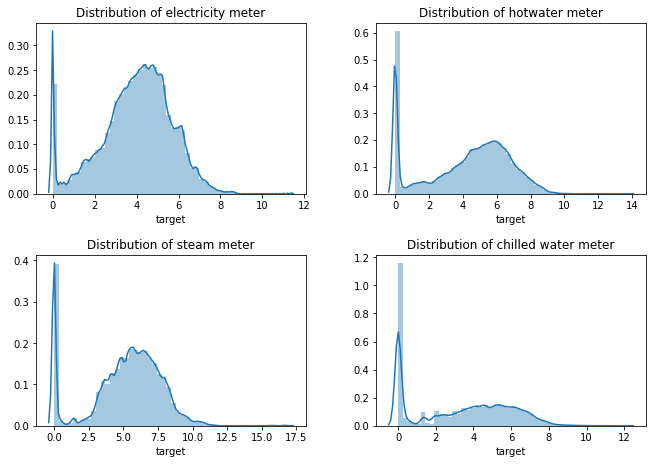

In [26]:
fig, axs = plt.subplots(ncols = 2, nrows= 2, figsize=(10, 7), facecolor='w', edgecolor='k')
# pad each plot
fig.tight_layout(pad=4.0)

row = 0
col = 0
m_type = ["electricity", "hotwater", "steam", "chilled water"]
for i in range(4):
  if i == 2:
    row += 1
    col = 0
  sns.distplot(train_df.target[train_df.meter == i], ax= axs[row][col])
  axs[row][col].title.set_text(f'Distribution of {m_type[i]} meter')
  col += 1

# Observation
* All the meter types contain a high 0 meter reading value, which is ok in all other cases except for the electricity meter (we have discussed the measures to tackle this in the above plots).

# Lets see if there is any relationship between building id and site id


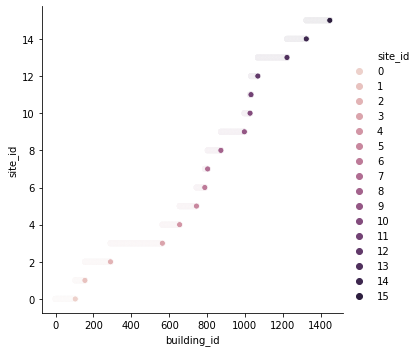

In [11]:
# regression plot to capture a relationship (if any exist) between site id and building id
sns.relplot(x= "building_id", y= "site_id", hue= "site_id", data= building_meta_df, legend="full")

## Observation
There is a positive relation between site id and building id. What does it mean?

It means, Building whose id is close, are actually close to each other (building id 45 is much closer to the building is 47 than building id 100 or building id 1.). Why this is important?

So if any site went down (due to some reason, maybe power outage or some natural disaster happens), there is a high probability that meter reading of buildings located at the same site will have a similar effect (because buildings are close to each other).

It also seems building ids are assigned in a sequential manner, one after another.

You can also see most of the buildings are from site 3, and hence the majority of train data has come from site 3.

In [13]:
# count the unique building in a particular site
building_count = train_df.groupby("site_id").agg({"building_id": "nunique"}).reset_index()

Text(0.5, 1.0, 'Count of building site wise')

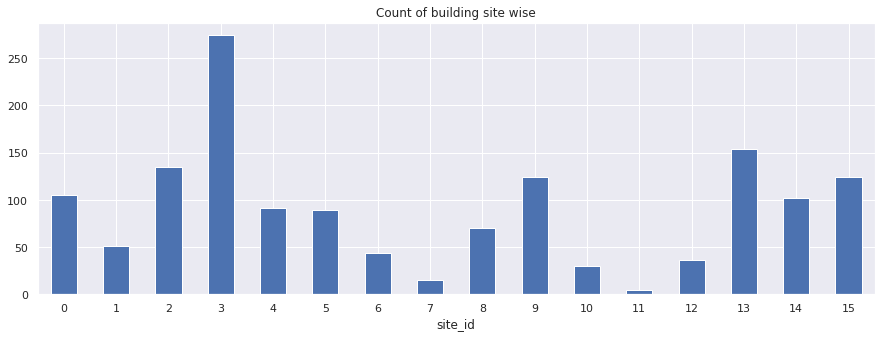

In [22]:
fig, ax = plt.subplots()
building_count.plot.bar(x= "site_id", y= "building_id", rot=0, ax= ax)
ax.get_legend().remove()
plt.title("Count of building site wise")

# Observation
* Majority of the building is from site 3 followed by site 13.

# Meter type count

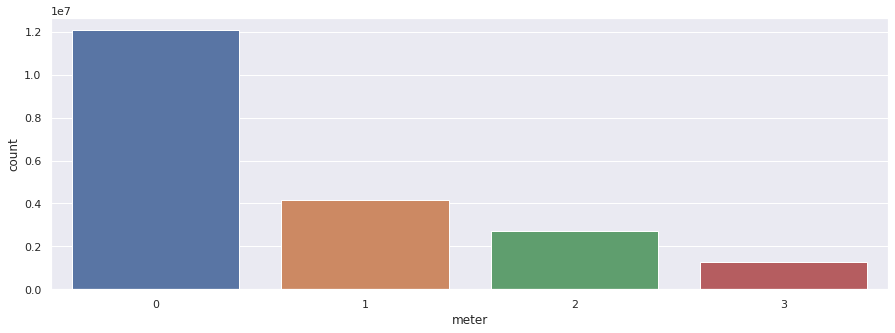

In [23]:
# count plot of meter types
sns.countplot(train_df.meter)

* As expected, most of the meter reading is from the electricity meter, not all the buildings as all the meters after all

# Median of meter reading by site id for each meter type per week/day
I feel site id is an important factor because It defines building location, and buildings with the same site id are close to each other. Weather information will be the same for all the buildings that are at a particular site

Here site id is like a buildings cluster. So we will analyze the target variable from the site id perspective

In [8]:
# total no of site IDs present
print("Total no of site IDs", *building_meta_df.site_id.unique())
# number of meter type per site id
site_id_meter = {}
# for each site id
for i in tqdm(range(0, 16)):
    # get all the building IDs locate at ith site
    site_id_buildings_id = building_meta_df.building_id[building_meta_df.site_id == i]
    
    # get meter reading of all the buildings located at current site (site i)
    site_df = train_df[train_df.building_id.isin(site_id_buildings_id.values)]
    
    site_id_meter["site_id_"+str(i)] = site_df.meter.unique()
    
    # print site_id and meter type present
for site_id, meter_type_list in site_id_meter.items():
    print("Meter types present in {} is {}".format(site_id, meter_type_list))

Total no of site IDs 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15



Meter types present in site_id_0 is [0 1]
Meter types present in site_id_1 is [0 3]
Meter types present in site_id_2 is [0 1 3]
Meter types present in site_id_3 is [0]
Meter types present in site_id_4 is [0]
Meter types present in site_id_5 is [0]
Meter types present in site_id_6 is [0 2 1]
Meter types present in site_id_7 is [1 2 0 3]
Meter types present in site_id_8 is [0]
Meter types present in site_id_9 is [0 1 2]
Meter types present in site_id_10 is [0 1 3]
Meter types present in site_id_11 is [0 3 1]
Meter types present in site_id_12 is [0]
Meter types present in site_id_13 is [0 1 2]
Meter types present in site_id_14 is [0 1 3 2]
Meter types present in site_id_15 is [3 0 1 2]


**There are a total of 16 site ids (locations where buildings are located and collected data from)**

*Note, not all the site has all the meter type, for sites like 3, 4, 5, 8, 12 there is just 1 meter type, which is meter 0 (electricity)

* We will create a data frame for each of these site ids and analyze them independently 

# Median of meter reading week wise per site

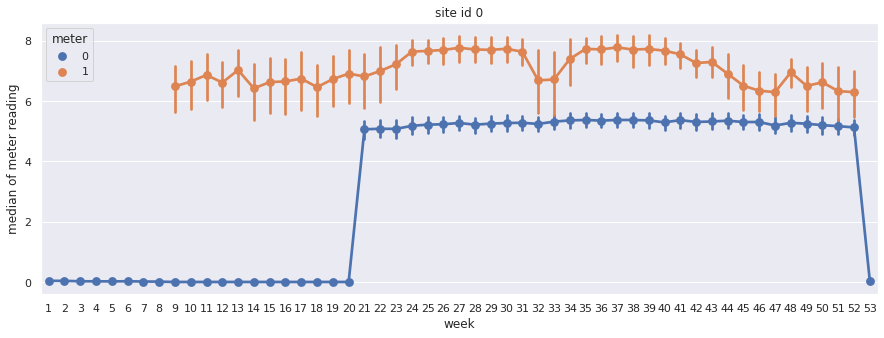

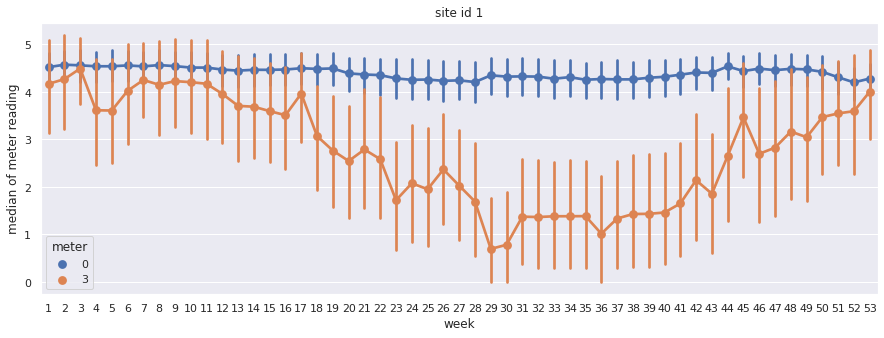

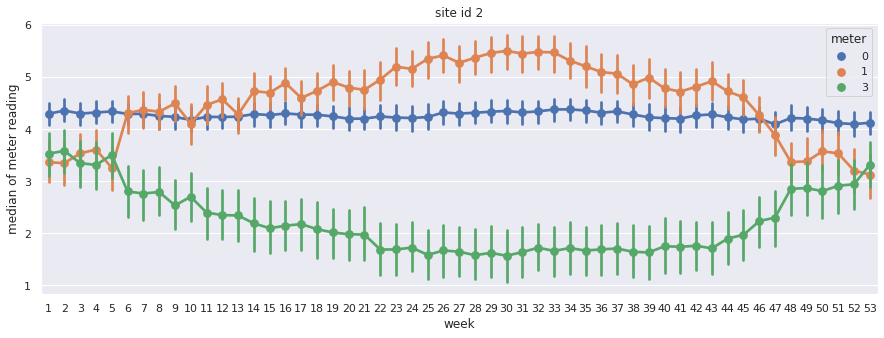

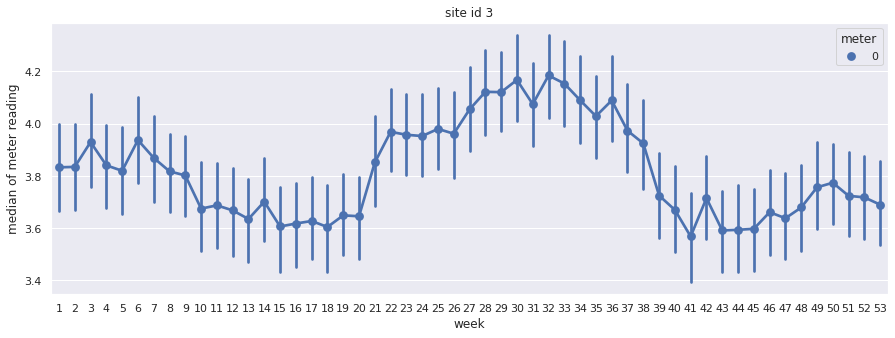

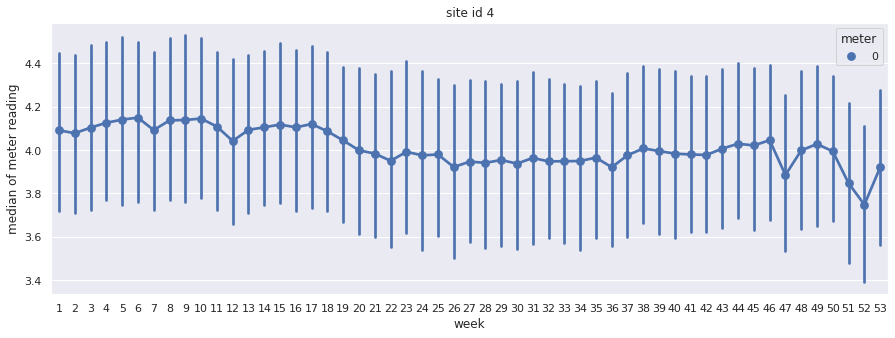

...

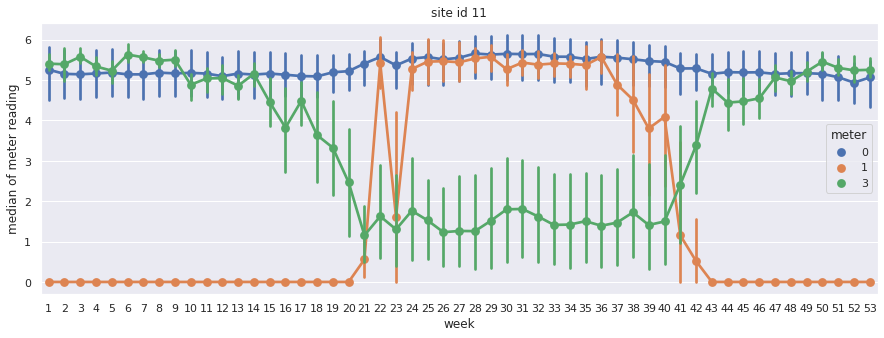

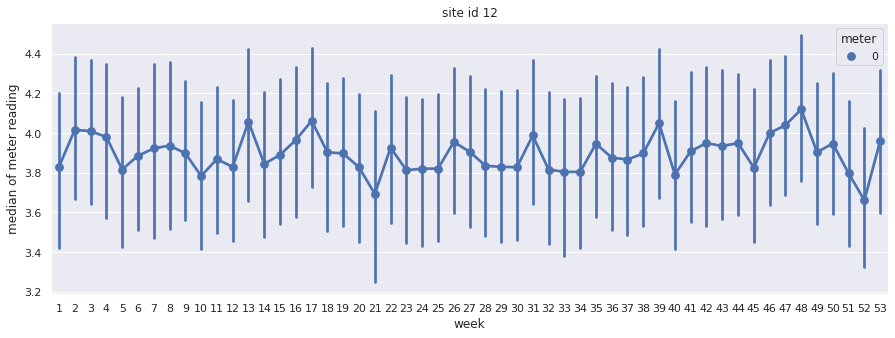

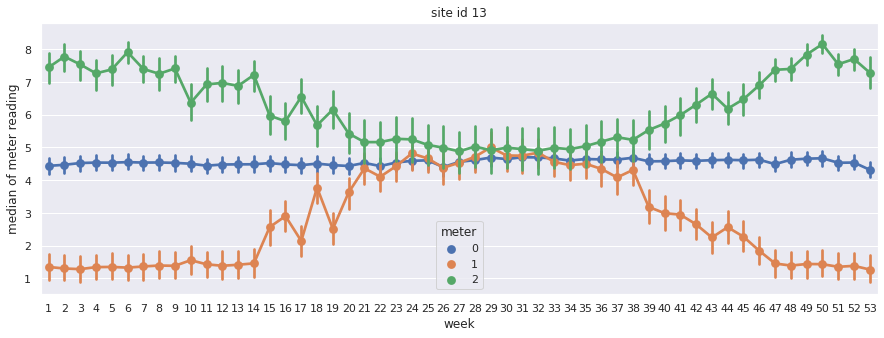

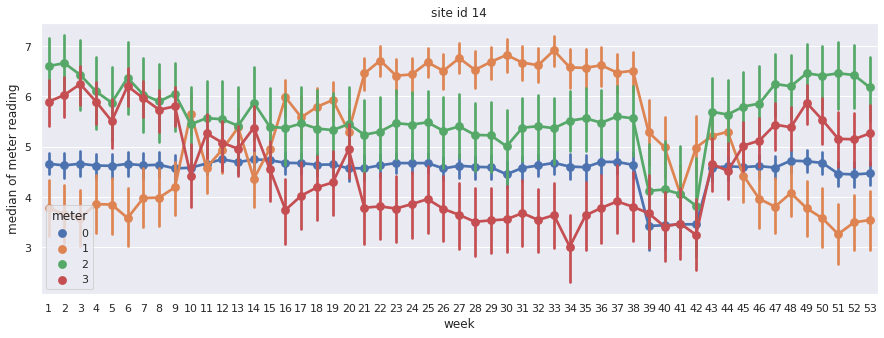

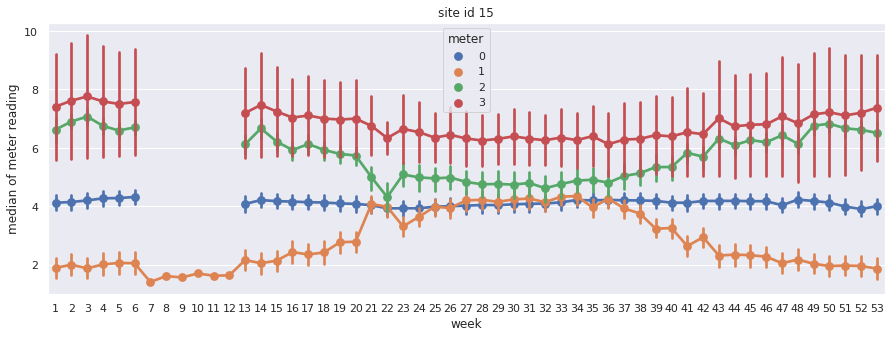

In [10]:
'''
for each site id, compute median of meter reading across week
'''
# dictionary to hold site id and building IDs of corresponding site id
site_id_df = {}

# for each site id
for i in range(16):
    # get all the building IDs locate at ith site
    site_id_df["site_id_"+str(i)] = building_meta_df.building_id[building_meta_df.site_id == i]
    
    # get meter reading of all the buildings located at current site (site i)
    site_df = train_df[train_df.building_id.isin(site_id_df["site_id_"+str(i)].values)]
    
    # group data by building id, week and week
    building_week_groupby = site_df[["building_id", "week", "meter", "target"]].groupby(["building_id", "week", "meter"])
    # compute median of meter reading
    building_median_week = building_week_groupby.agg({"target": "median"}).reset_index()
    # update column name
    building_median_week.rename(inplace=True,columns= {"target": "median_week"})
    # create a new plot
    plt.figure()
    sns.pointplot(x= "week", y= "median_week", hue="meter", data= building_median_week).set_title("site id " + str(i))
    plt.ylabel("median of meter reading")
    plt.show()

# Observations
We are having good visualization of how to meter reading behaves at different sites.

* There is almost always opposite relation between meter 1 and meter 2 & 3 (combined). When 1 increases other decrease and vice-versa. It is obvious because meter one is a chilled water meter and 2 and 3 are stem and hot water. So people usually use chilled water in summertime and hot/steam in the wintertime.

* Site id 15 buildings are missing meter reading from week 6 to week 12 for meters 0, 2, and 3. (what could be the reason?)

* Site id 0 has missing data for meter 1 (chilledwater) and zero meter reading for meter 0 (electricity meter). We will remove this as we don't have any prior data regarding these meter type

* In most of the sites, meter 0 (electricity) doesn't vary much. Except for site 3, 4, 5, 8 & 12

# EDA on weather file

In [24]:
# looking at data
weather_train_df.head()

,site_id,timestamp,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,sea_level_pressure,wind_direction,wind_speed,dayofyear,day,week,hour,month,weekend
0,0,2016-01-01 00:00:00,25.0,6.0,20.0,NaN,1019.7,0.0,0.0,1,1,53,0,1,0
1,0,2016-01-01 01:00:00,24.4,NaN,21.1,-1.0,1020.2,70.0,1.5,1,1,53,1,1,0
2,0,2016-01-01 02:00:00,22.8,2.0,21.1,0.0,1020.2,0.0,0.0,1,1,53,2,1,0
3,0,2016-01-01 03:00:00,21.1,2.0,20.6,0.0,1020.1,0.0,0.0,1,1,53,3,1,0
4,0,2016-01-01 04:00:00,20.0,2.0,20.0,-1.0,1020.0,250.0,2.6,1,1,53,4,1,0


In [54]:
# get the count of nan value rows columnwise
weather_null_count = weather_train_df.isna().sum().reset_index()
# alter the column name
weather_null_count.rename(columns={"index": "column_name", 0: "missing_row_count"}, inplace= True)
# compute the percentage and add new percentage column
weather_null_count["missing_row_percentage"] = weather_null_count.missing_row_count/weather_train_df.shape[0]

Text(0, 0.5, 'Missing percentage')

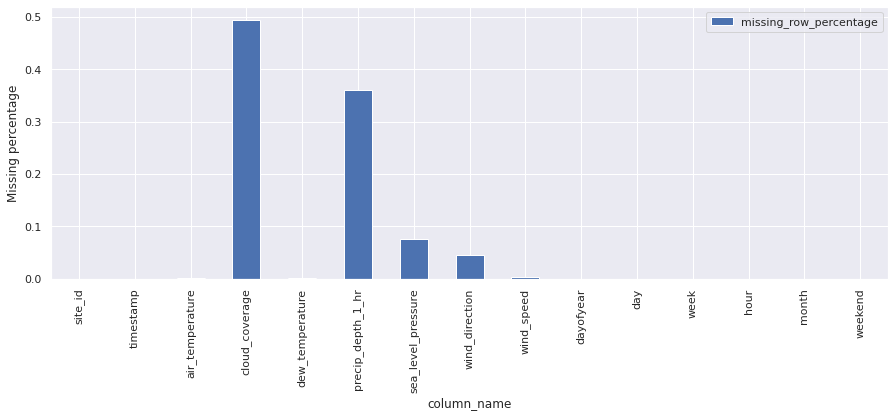

In [61]:
weather_null_count.plot.bar(x= "column_name", y= "missing_row_percentage")
plt.ylabel("Missing percentage")

# Observation
The weather file contains weather information about a particular site at the given time.

There are a total of 139773 entries and 15 features

It contains missing values. Here is the brief summary:

* There are 6 columns which contains missing values (cloud_coverage dew_temperature, precip_depth_1_hr, sea_level_pressure, wind_direction, wind_speed)
* cloud_coverage has around 50% of the values that are missing, followed by precip_depth_1_hr which is around 0.36% of missing values. To address this issue, We will try to drop these two columns and see if it improve the metric. In the second phase, We will try to impute it and check if we get some significant boost.
* For the rest of the missing columns, we will impute it using ML models.

# Distribution of air_temperature, dew_temperature, sea_level_pressure, wind_direction and wind_speed over time

**Distribution of air temperature day wise**

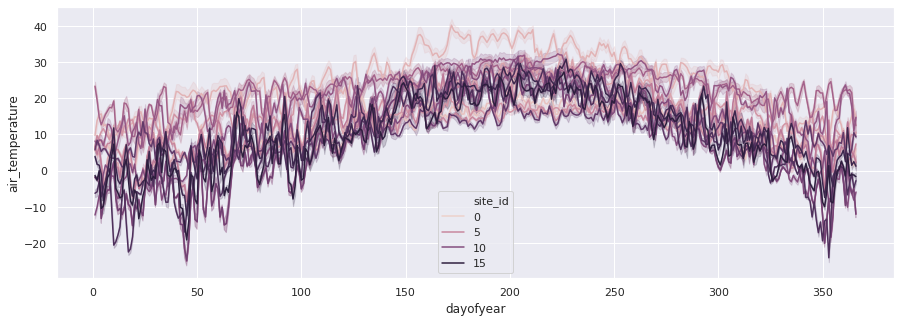

In [144]:
sns.lineplot(x= "dayofyear", y= "air_temperature", sea_level_pressure, data= weather_train_df, hue= "site_id")

**Distribution of dew temperature day wise**

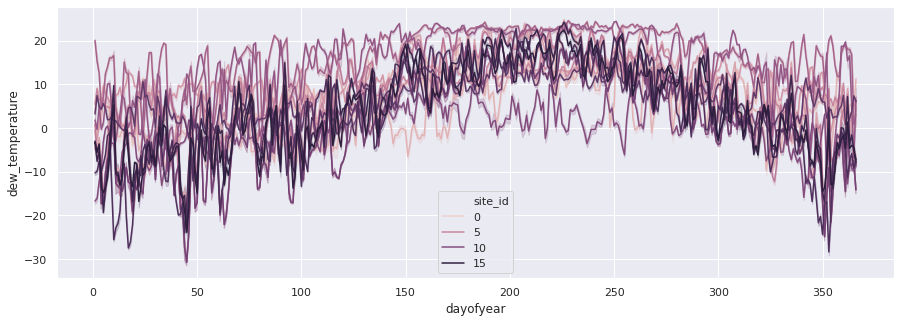

In [145]:
sns.lineplot(x= "dayofyear", y= "dew_temperature", data= weather_train_df, hue= "site_id")

**Distribution of sea level pressure day wise**

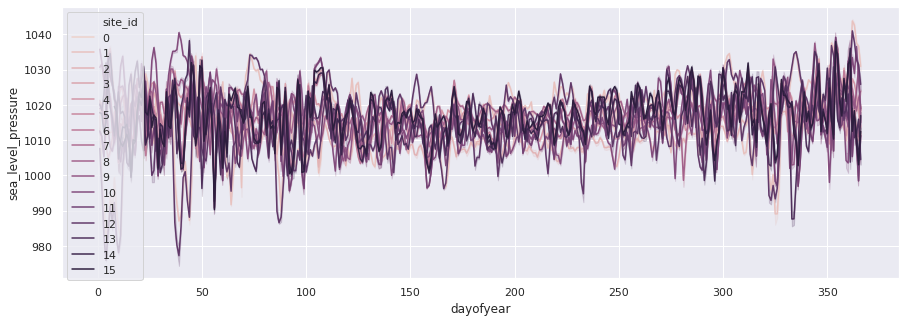

In [146]:
sns.lineplot(x= "dayofyear", y= "sea_level_pressure", data= weather_train_df, hue= "site_id", legend= "full")

**Distribution of wind direction day wise**

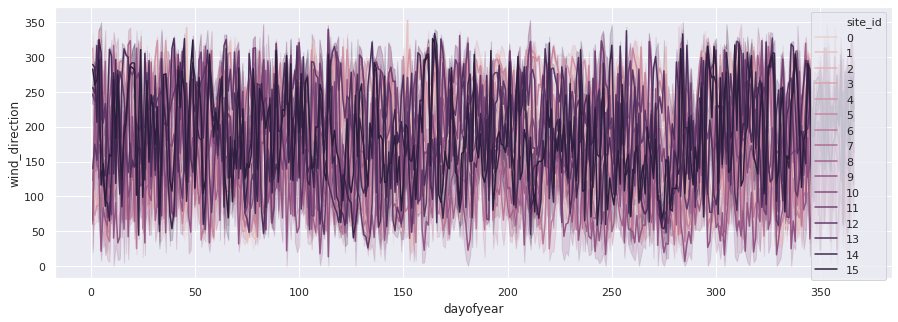

In [147]:
sns.lineplot(x= "dayofyear", y= "wind_direction", data= weather_train_df, hue= "site_id", legend= "full")

**Distribution of wind speed day wise**

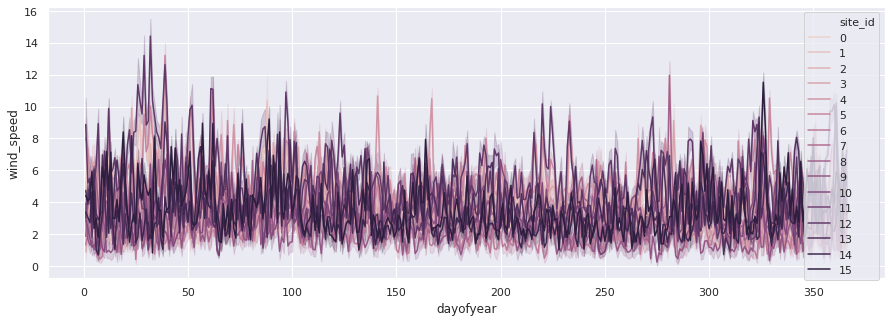

In [148]:
sns.lineplot(x= "dayofyear", y= "wind_speed", data= weather_train_df, hue= "site_id", legend= "full")

**Distribution of cloud coverage day wise**

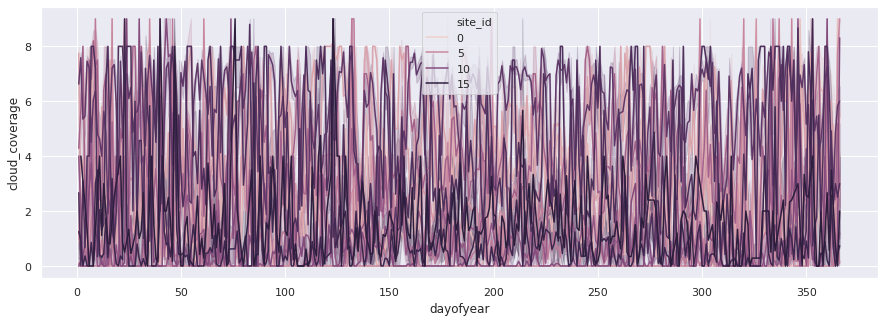

In [151]:
sns.lineplot(x= "dayofyear", y= "cloud_coverage", data= weather_train_df, hue= "site_id")

**Distribution of precip_depth_1_hr day wise**

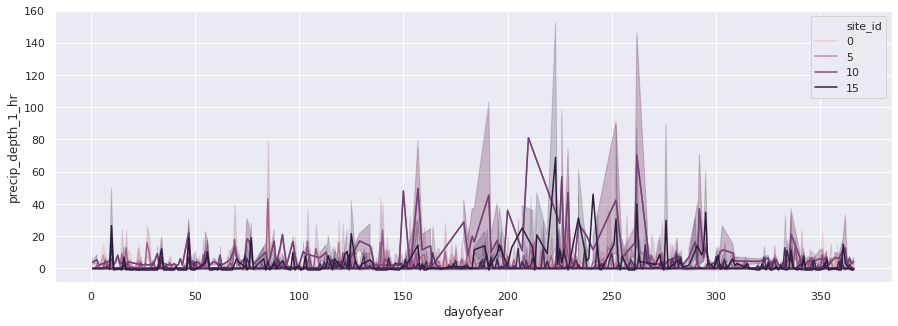

In [152]:
sns.lineplot(x= "dayofyear", y= "precip_depth_1_hr", data= weather_train_df, hue= "site_id")

# Observation
* By looking at the plot, there seems to a pattern in air_temperature, dew_temperature. It increases to the middle, then starts decreasing to the end (like U shape). I feel this variable should be helpful at the time of modeling.

* wind_direction, sea_level_pressure, cloud_coverage, precip_depth_1_hr, and wind_speed seem to have no pattern, They are around the same (or some random fluctuations ) across the time.

# Building meta analysis

In [96]:
# get summary of the data
building_meta_df.describe()

,site_id,building_id,square_feet,year_built,floor_count
count,1449.000000,1449.000000,1449.000000,675.000000,355.000000
mean,6.952381,724.000000,92111.776398,1967.957037,3.740845
std,5.003432,418.434583,110769.950997,31.054030,3.333683
min,0.000000,0.000000,283.000000,1900.000000,1.000000
25%,3.000000,362.000000,23012.000000,1949.000000,1.000000
50%,5.000000,724.000000,57673.000000,1970.000000,3.000000
75%,13.000000,1086.000000,115676.000000,1995.000000,5.000000
max,15.000000,1448.000000,875000.000000,2017.000000,26.000000


In [72]:
# get the sum of null rows, columns wise
building_meta_df.isna().sum()

(site_id           0
 building_id       0
 primary_use       0
 square_feet       0
 year_built      774
 floor_count    1094
 dtype: int64, (1449, 6))

* Building meta file contains 1449 rows (same as the number of unique buildings in the dataset) and 6 columns

* Oldest building was build in 1900 and newest was build in 2017

* Minimum building area is 283 and maximum is 875000

* Minimum floor count is 1 and the maximum is 26

* Build year seems to be missing for more than 50% of the building, so does floor_count. So we will drop these features and observe the metric

* Also as seen in the EDA notebook, there is a relation between site_id and building_id, We have to include these 2 features for sure.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 <a list of 16 Text major ticklabel objects>)

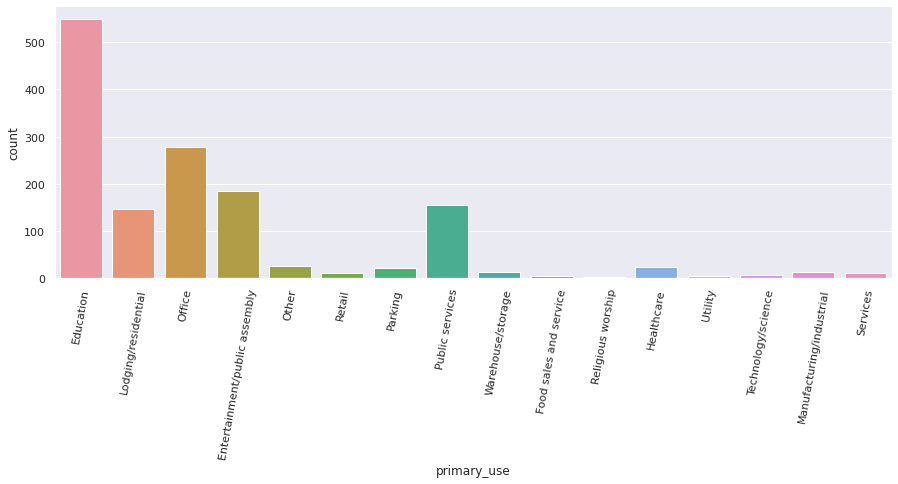

In [81]:
# count plot 
sns.countplot(building_meta_df.primary_use)
# rotate the labels by 80 degrees
plt.xticks(rotation= 80)

* Most of the building in this dataset is used for educational purpose, followed by office use, Entertainment/public assembly, Public services, Lodging/residential

# Distribution of building area

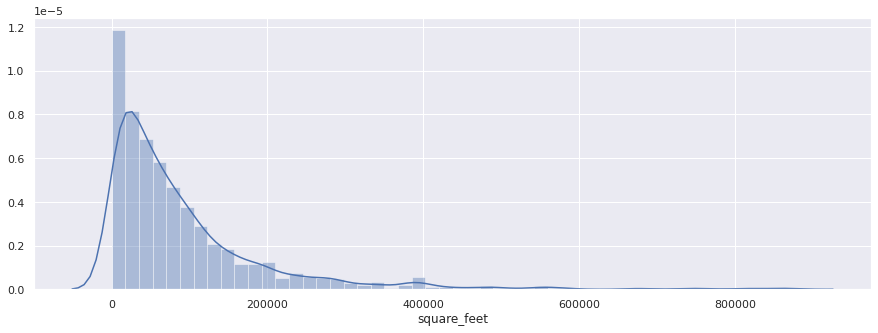

In [92]:
# distribution plot of area in square feet
sns.distplot(building_meta_df.square_feet)

# Observation
The distribution is positively skewed. There are few buildings whose area is more than 200000 square feet. To make it look more normal, we will apply log transformation while modeling the data.

# Capturing the relationship between meter reading and square feet area

In [132]:
# compute median of meter reading across buildings
df_median_meter_reading = train_df.groupby("building_id").agg({"target": "median"}).reset_index()
# bringing square_feet area to the same scale
building_meta_df["square_feet"] = np.log1p(building_meta_df["square_feet"])
# merget both the dataframe
df_merged = df_median_meter_reading.reset_index().merge(building_meta_df[["building_id", "square_feet", "primary_use"]], on="building_id", how='left')

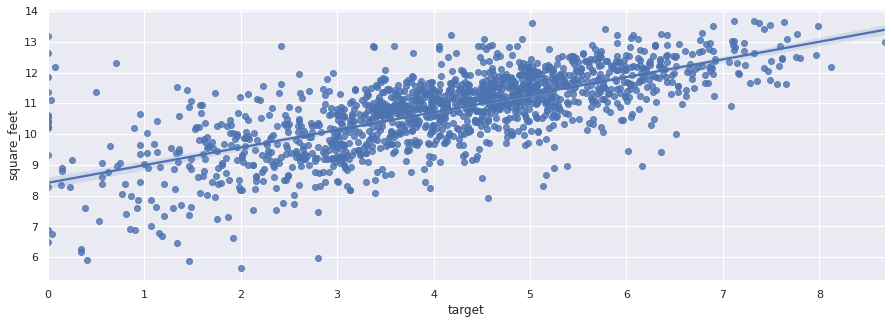

In [129]:
# regplot
sns.regplot(x = "target",y= "square_feet" , data= df_merged)

# Observation
* we can clearly see positive relation between median meter reading and square feet (in log scale). The area of the building could be helpful at the time of modeling the problem

# References

[Simple Exploration Notebook - ASHRAE](https://www.kaggle.com/sudalairajkumar/simple-exploration-notebook-ashrae)

[Missing data and zeros visualized](https://www.kaggle.com/ganfear/missing-data-and-zeros-visualized)

# End Note
 Data visualization is the initial and crucial part of data analysis to make assumptions, prove hypotheses, detect outliers, and help us to make decisions on future analysis (modeling).

Here we have visualized some insight, detected outlier, and looked features which I feel will be important at the inference time.